## What is t-SNE?

[The original paper](http://jmlr.org/papers/volume9/vandermaaten08a/vandermaaten08a.pdf) that proposes t-SNE describes it as follows:

> “"t-Distributed stochastic neighbor embedding (t-SNE) minimizes the divergence between two distributions: a distribution that measures pairwise similarities of the input objects and a distribution that measures pairwise similarities of the corresponding low-dimensional points in the embedding." —van der Maaten and Hinton, 2008

Like PCA, t-SNE is a dimensionality reduction technique that tries to find a good representation of high-dimensional data in low-dimensional space. To accomplish this, t-SNE measures the similarity between data points in both high-dimensional space and low-dimensional space; then it tries to minimize the divergence between the two similarities calculated in the high- and low-dimensional spaces. To understand where t-SNE's underlying ideas come from and how the approach differs from other dimensionality reduction techniques, watch [Visualizing Data Using t-SNE](https://www.youtube.com/watch?v=RJVL80Gg3lA), where Laurens van der Maaten discusses the t-SNE algorithm.

Before learning about the t-SNE algorithm, briefly compare PCA and t-SNE so that you can better understand what t-SNE accomplishes.

## Differences between PCA and t-SNE

1. PCA tries to preserve the large pairwise distances between the data points. In contrast, t-SNE tries to preserve the small pairwise distances between the data points. **Hence, t-SNE better represents the local similarities in the data, whereas PCA better represents the dissimilarities in the data.** That is to say, if two points are close together in high-dimensional space, they have a high probability of being close together in the low-dimensional space that t-SNE produces.

2. PCA is a linear method that tries to retain the variance in the data as much as it can. In contrast, t-SNE is a nonlinear method that minimizes the divergence between the distributions of the high-dimensional data and the low-dimensional representation that it produces. This means that PCA isn't as effective at discovering nonlinear relationships between the observations. Hence, instead of PCA, you should use t-SNE to preserve the similarities between observations that can only be measured in a nonlinear way. This makes t-SNE very useful, especially for image, audio, and text data, where nonlinearity is common.

For these reasons, t-SNE is generally preferred—especially for image, audio, and text data. However, as you'll learn soon, the runtime of t-SNE is much higher than the runtime of PCA. As a result, choosing between PCA and t-SNE involves weighing a trade-off between speed and information.

## The t-SNE algorithm

Now, you'll explore the algorithm that t-SNE uses to produce the lower-dimensional representation of the data. The algorithm consists of three steps, and you'll examine each step alongside mathematical formulas to help you understand the ideas more clearly.

Let $\left| x_i - x_j \right|$ denote the Euclidean distance (L2 norm) between two data points in the original space. Let $\left| y_i - y_j \right|$ denote the distance between the associated points in the lower-dimensional representation.

1. t-SNE starts with calculating a similarity matrix between the data points in the original high-dimensional space, using this equation:

$$ p_{j|i} = \frac{\exp\left(-\left| x_i - x_j\right|^2 \big/ 2\sigma_i^2\right)}{\displaystyle\sum_{k \neq i} \exp\left(-\left| x_i - x_k\right|^2 \big/ 2\sigma_i^2\right)}$$

This measures how distant $x_j$ is from $x_i$, considering a Gaussian distribution around $x_i$ with a given variance $\sigma_i^2$. The t-SNE algorithm assumes that a Gaussian distribution can be used to approximate the data. It also assumes that each data point has a different variance; these variances are chosen such that points in dense areas are given a smaller variance than points in sparse areas. This program won't go into the details of how this variance is computed, but you can read about it in the original paper.

Notice that according to the equation above, $p_{j|i}$ and $p_{i|j}$ might differ. To overcome this issue, t-SNE defines the similarity as a symmetrized version of the conditional similarities, as follows:

$$ p_{ij} = \frac{p_{j|i} + p_{i|j}}{2N}$$


2. Next, t-SNE calculates another similarity matrix. This similarity matrix is calculated between the data points in the reduced low-dimensional space, using this equation:

$$ q_{ij} = \frac{f(\left| x_i - x_j\right|)}{\displaystyle\sum_{k \neq i} f(\left| x_i - x_k\right|)}\: , with\: f(z) = \frac{1}{1+z^2}$$

This is the same idea as above. But in the lower-dimensional space, t-SNE uses a different distribution, the t-Student distribution, with one degree of freedom. This distribution is also known as the *Cauchy distribution*. This is another assumption of the t-SNE algorithm, and you'll explore how Gaussian and Cauchy distributions are different shortly.

Now, if the similarity matrix $\big(p_{ij}\big)$ in the original space is fixed, the similarity matrix $\big(q_{ij}\big)$ in the reduced space depends on how you choose the representation points. t-SNE wants these two matrices to be as close as possible, which in turn ensures that similar data points yield similar representation points.

3. In the last step, t-SNE tries to minimize the *Kullback-Leibler (KL) divergence* between the original similarity distribution and the reduced representation distribution. Kullback-Leibler divergence is a measure of how much two distributions differ from each other. For the two distributions $P$ and $Q$, Kullback-Leibler divergence is defined as follows:

$$ KL(P||Q) = \sum_{i, j} p_{ij}  \log \frac{p_{ij}}{q_{ij}}$$

This measures the distance between the two similarity matrices.

To minimize this score, t-SNE performs gradient descent. The gradient can be computed analytically, as seen here:

$$ \frac{\partial , KL(P || Q)}{\partial y_i} = 4 \sum_j (p_{ij} - q_{ij}) g\left( \left| x_i - x_j\right| \right) u_{ij}\: , where\: g(z) = \frac{z}{1+z^2}$$

Here, $u_{ij}$ is a unit vector going from $y_j$ to $y_i$.

All the iterations that you can see in the animation above are due to the optimization process of the KL divergence using the gradient descent method. At each iteration, the lower-dimensional representation is upgraded so that the KL divergence of it between the high-dimensional representation is reduced.

### Cauchy versus Gaussian distributions

You may wonder why t-SNE uses different distributions to model the similarity in the original and the reduced spaces. To understand why t-SNE uses a Cauchy distribution instead of a Gaussian distribution for the similarity in the lower-dimensional space, consider the example below. In this example, three points in two-dimensional space will be transformed into one-dimensional space.

In the left part of the image below, the distances between three points in two-dimensional space are given. The distance between the first and the third points is also shown, as a red line. In the right part of the image, two different reduced representations using t-SNE are given. In the upper part, the transformation is done using Gaussian distribution. And in the bottom part, the transformation is done using a Cauchy distribution.

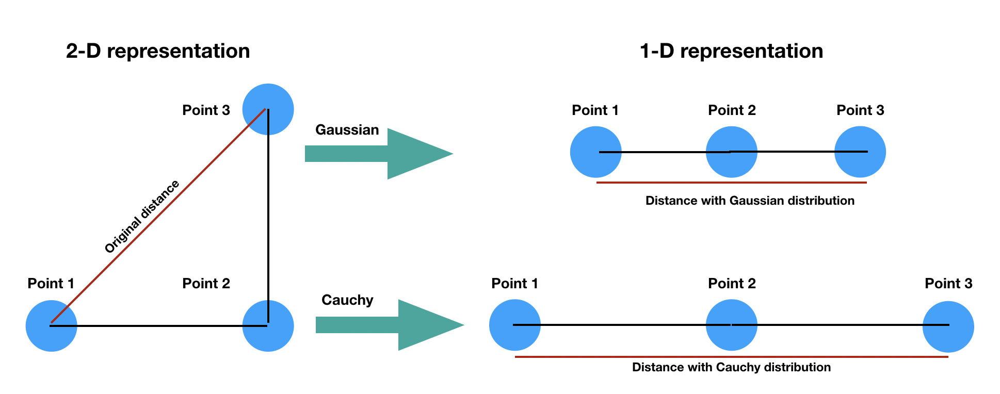

As you can see, using a Cauchy distribution causes the distance between the first and the third points to become more emphasized as the points are placed further away from each other on the line. The effect is much more pronounced than it is in a Gaussian distribution. In effect, using a Cauchy distribution enables t-SNE to separate the dissimilar points in the reduced space. Hence, in this way, t-SNE tries to retain local similarities and highlight the global dissimilarities in the low-dimensional space. You'll see how successfull t-SNE achieves this on the *MNIST* data below.

But what is the difference between Cauchy and Gaussian distributions? As you can see in the figure below, the Cauchy distribution is more fat tailed than the Gaussian distribution:

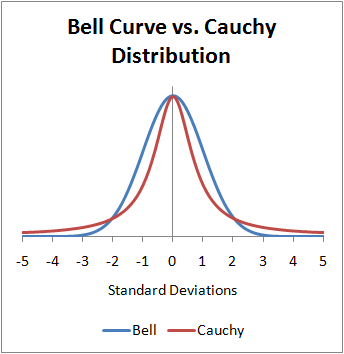

When reducing the dimensionality of a dataset, if you were to use the same Gaussian distribution for the original data points and the reduced ones, you would get an imbalance in the distribution of the distances of a point's neighbors. This is because the distribution of the distances is so different between a high-dimensional space and a low-dimensional space. Yet, the algorithm tries to reproduce the same distances in the two spaces.

The t-SNE algorithm works around this problem by using a Cauchy distribution in the lower-dimensional space. This distribution has a much heavier tail than the Gaussian distribution, and this compensates for the original imbalance. For a given similarity between two data points, the two corresponding lower-dimensional representations will need to be much further apart in order for their similarity to match the data similarity.

### Important points to consider

* t-SNE isn't a clustering algorithm—it's a dimensionality reduction algorithm. So you shouldn't make any inference based on only the output of t-SNE. t-SNE is used mainly for data exploration and visualization. Cluster sizes in t-SNE plots must not be evaluated for variance or dispersion. This is because t-SNE expands denser clusters and contracts sparser clusters to make them similar sizes, and this is one of the reasons for the clear plots that it produces.

* If you have variables of different scales and you want t-SNE to treat each variable equally, then standardizing the features before applying t-SNE is important. The L2 norm (Euclidean distance) is especially sensitive to the scaling of the data.

* t-SNE scales quadratically in the number of observations. This limits its applicability to datasets with only a few thousand data points; for larger datasets, the computation time of t-SNE becomes too high. The algorithm you'll learn about next in this module is more suitable for large datasets.

* Similar to the point above, t-SNE also runs very slowly if the dimensionality of the data is too large. So, it is a common practice to first reduce dimension (to 50, for example) first using another dimensionality reduction algorithm like PCA.

* t-SNE is a probabilistic algorithm. So, different runs with the same hyperparameters may produce different results, and you should be careful when analyzing the data based on a single t-SNE plot. If possible, multiple plots should be observed before making any assessment.

* When applying t-SNE, you need to make some decisions about the values of the algorithm's hyperparameters. The hyperparameters of t-SNE are the perplexity and the number of iterations to stop. For the algorithm to execute properly, the perplexity should be smaller than the number of points. Also, the suggested perplexity is in the range of 5-50. However, the best way to decide on the values of the hyperparameters is to apply k-fold cross-validation.

### Speed

t-SNE computes pairwise conditional probabilities and tries to minimize the sum of the difference of the probabilities in the original and the lower dimensions. This involves a lot of calculations and computations. Actually, the algorithm has quadratic time and space complexity in the number of data points. This makes it a slow algorithm as well as resource intensive when applied to data consisting of more than 10,000 observations.

So, using t-SNE for large datasets might be impractical. So that you can reduce the computational time, you'll look at another algorithm next in this module. That algorithm is similar to t-SNE on achievements but runs much faster.

# t-SNE in action

Now, you'll learn how to apply t-SNE and see what it produces on the *MNIST* dataset. You've learned that *MNIST* is a dataset consisting of handwritten digit images. When you attempted to visualize *MNIST* images in two-dimensional space using PCA, you saw that **PCA highlighted only how far the digits are away from each other, and not how close the similar digits are**. Here, you'll apply t-SNE to the *MNIST* data and see that the same digits cluster together and distinct digits separate from each other.

Begin by importing the libraries that you'll use. Notice that t-SNE lives in the manifold module of scikit-learn.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
from sklearn.datasets import fetch_openml
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

As usual, load the *MNIST* dataset using the `fetch_openml()` function of scikit-learn's datasets module.

**Note:** You don't have to use this method to download the *MNIST* dataset. It's [available online](http://yann.lecun.com/exdb/mnist/), so you can also download the dataset from that link and then load it in your own way. Notice that the dataset in the link is separated into two (as training and test sets), but this example will use the combined version here. You can combine the training and test sets into one, or you can just use the training set. The results will look similar to each other.

If you want to use the `fetch_openml()` function and your version of scikit-learn is older than `0.20`, you can upgrade your installation by running the following code on the command line:

```bash
pip install --upgrade scikit-learn
```

Once you get the required version, you can load the *MNIST* data:

In [2]:
mnist = fetch_openml('mnist_784', version=1, parser='auto', cache=True)

As mentioned before, t-SNE runs slowly, especially when applied to datasets that are larger than 10,000 observations. Because of this, you'll randomly select a sample of 10,000 images from the 70,000 images of the *MNIST* dataset, as shown below. You'll apply t-SNE on this sample.

In [3]:
np.random.seed(123)

indices = np.random.choice(len(mnist.data), 10000)
X = mnist.data.loc[indices] / 255.0
y = mnist.target.loc[indices]

print(X.shape, y.shape)

(10000, 784) (10000,)


Now, it's time to apply t-SNE. Because you want to visualize the *MNIST* data in two dimensions, `n_components=2` is set in the `TSNE` class. In the code below, `perplexity=40` and `n_iter=300` are also set. You can play around with the perplexity and the number of iterations and see how the results change.

In [4]:
time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.063s...
[t-SNE] Computed neighbors for 10000 samples in 6.284s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 2.182897
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.245399
[t-SNE] KL divergence after 300 iterations: 2.791986
t-SNE done! Time elapsed:

Now, you can plot the *MNIST* data using the t-SNE components. In the figure below, each data point is colored and labeled according to its true digit. This is meant to make it easier to understand how useful the t-SNE representations are.

In [5]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(tsne_results.shape[0]):
    plt.text(tsne_results[i, 0], tsne_results[i, 1], str(y.iloc[i]),
             color=colours[int(y.iloc[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

All the digit classes seem to be quite well separated from each other, in contrast to the PCA representation that you explored before. This is because t-SNE preserves the local similarities. Because the observations that belong to the same digit class are similar to each other, you see them clustered together in the two-dimensional representation of t-SNE. This is great; in a realistic scenario, you may have no access to the class or group information of the examples. Even in this case, you can identify the different groups from t-SNE's low-dimensional representations. To illustrate this, plot the same graph as above, this time without coloring or labeling the data points:

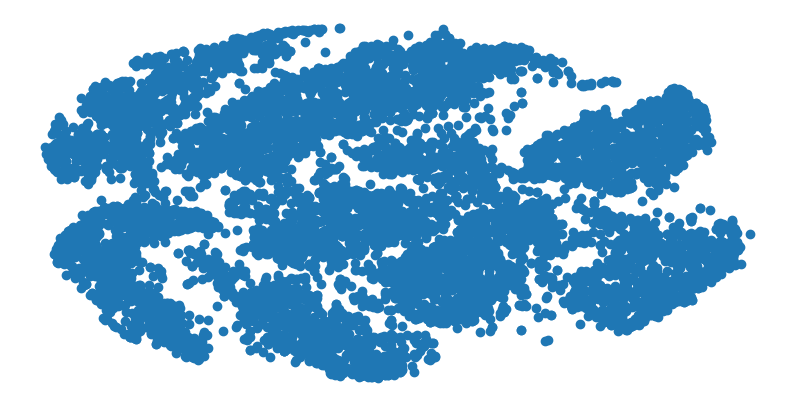

In [6]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

You can clearly identify nine different groupings above. The only indistinguishable digits are the `4` and `9`, which are intertwined with each other at the bottom of the graph. If you have enough resources and time, you can run the t-SNE algorithm on the full *MNIST* data (70,000 images) and check whether t-SNE could come up with a representation that also distinguishes between the `4` and `9` values.

### Q1. Now, continue working with the [fashion MNIST dataset](https://github.com/zalandoresearch/fashion-mnist). For the sake of comparability, use the same 10,0000-observation sample that you used in the previous lesson.

### a) Load the dataset and conduct any necessary preprocessing, such as normalizing the data.

In [7]:
mnist = fetch_openml('Fashion-MNIST', version=1, parser='auto', cache=True)

In [8]:
# Reduce to 10,000 observations
np.random.seed(123)

indices = np.random.choice(len(mnist.data), 10000)
X = mnist.data.loc[indices] / 255.0
y = mnist.target.loc[indices]

print(X.shape, y.shape)

(10000, 784) (10000,)


### b) Apply t-SNE to the data by setting `n_components=2`.


In [9]:
time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.032s...
[t-SNE] Computed neighbors for 10000 samples in 3.532s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 1.836339
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.881973
[t-SNE] KL divergence after 300 iterations: 2.510555
t-SNE done! Time elapsed:

### c) Using the two-dimensional t-SNE representation, draw a graph of the data by coloring and labeling the data points

In [10]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(tsne_results.shape[0]):
    plt.text(tsne_results[i, 0], tsne_results[i, 1], str(y.iloc[i]),
             color=colours[int(y.iloc[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### d) Do you think that the t-SNE solution is satisfactory? Can you easily distinguish between the different classes? Which algorithm produced better results, t-SNE or the PCA that you applied in the previous lesson's assessment?

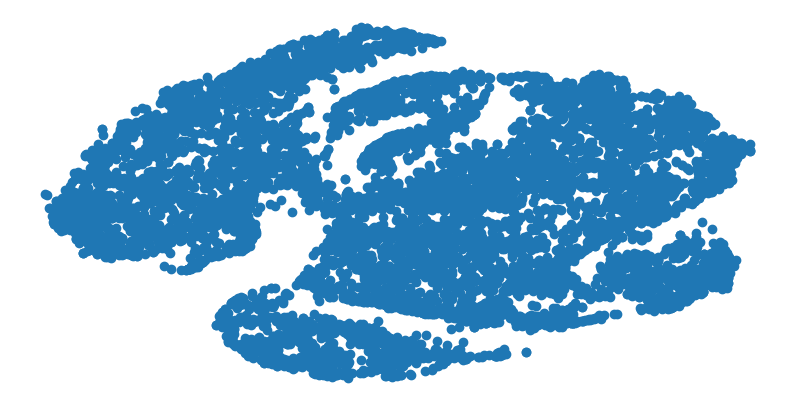

In [11]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

It is significantly easier to distinguish between the different classes in t-SNE. For this dataset, it is easier to do data visualization through t-SNE (as opposed to PCA).

### e) Now, play with the different `perplexity` values and apply t-SNE for each of them. Which perplexity value is best in terms of the two-dimensional representation clarity?

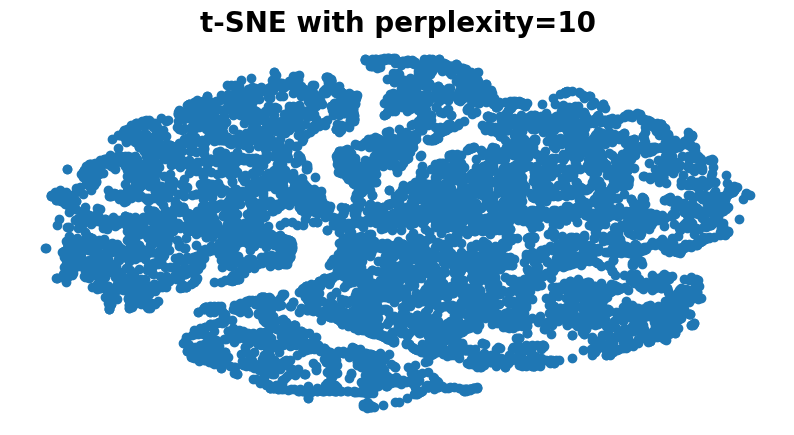

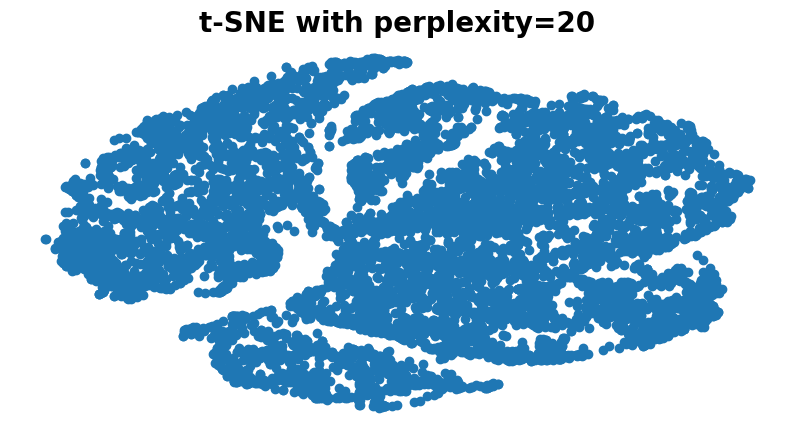

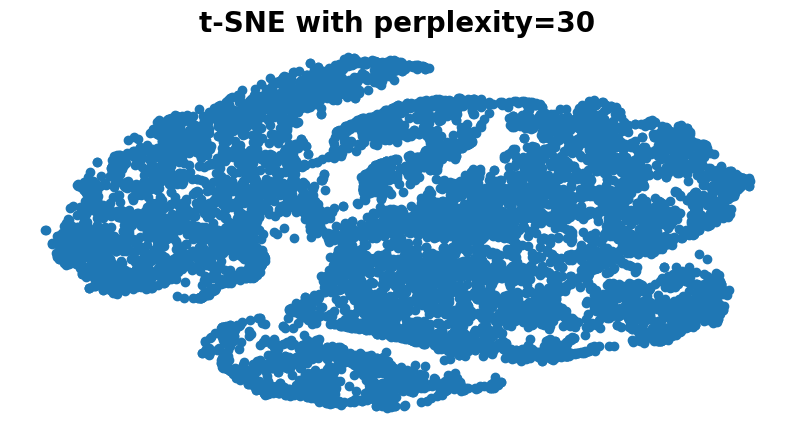

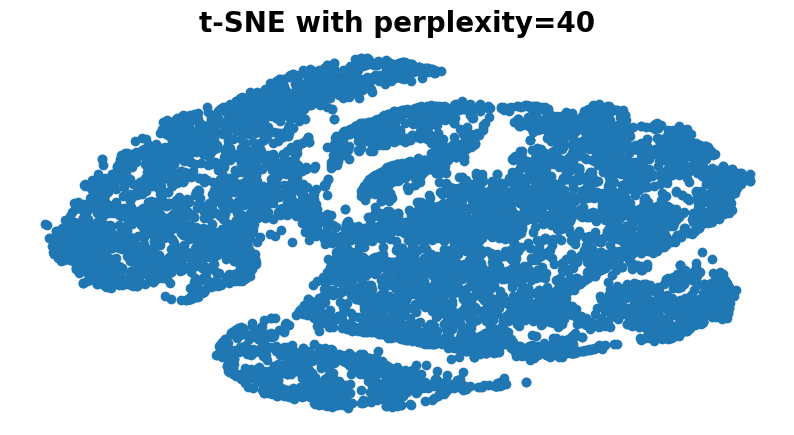

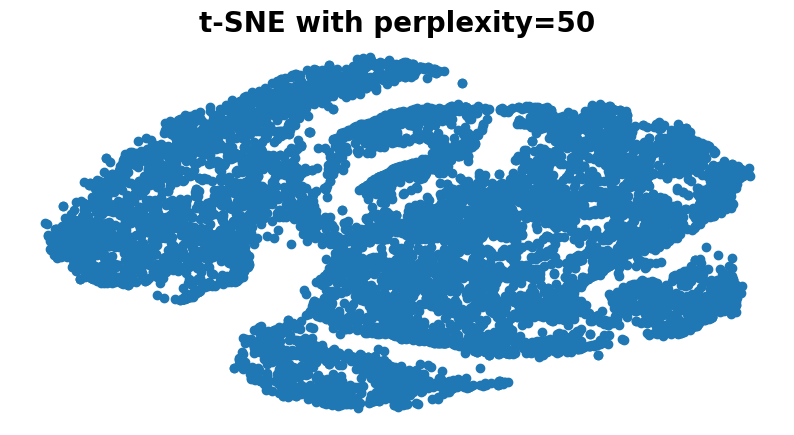

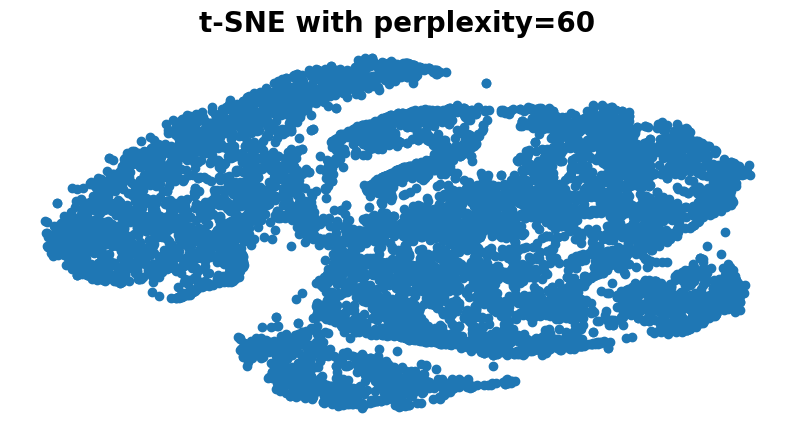

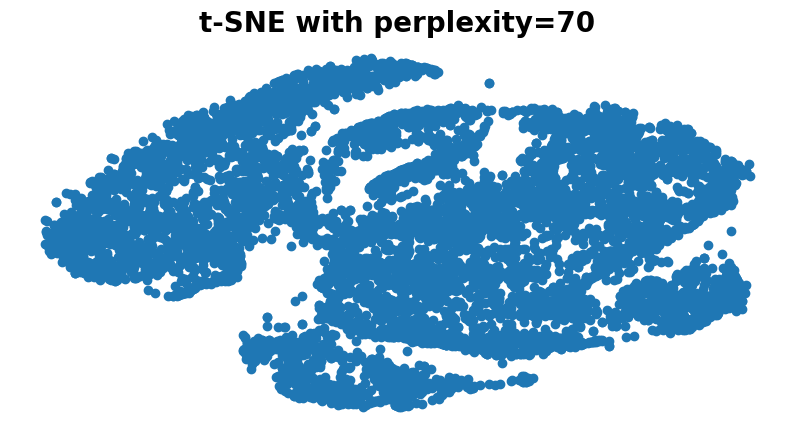

In [16]:
perplexities = [10,20,30,40,50,60,70]

for i,perp in enumerate(perplexities):
  tsne = TSNE(n_components=2, perplexity=perplexities[i], n_iter=300)
  tsne_results = tsne.fit_transform(X)

  plt.figure(figsize=(10,5))
  plt.title("t-SNE with perplexity={}".format(perplexities[i]), fontdict={'weight': 'bold', 'size': 20})
  plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

While all of `perplexity` values outperform the lower dimensional representation with PCA, it is unclear which value of `perplexity` gives the optimal result.